In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "-1"

import numpy as np
np.random.seed(12345)
import matplotlib.pyplot as pyp
import opus_plc_network

from mdct_funcs import *
from soft_smooth import *
from scipy.io import wavfile
from scipy.signal import lfilter

import IPython

2022-08-11 18:17:58.696428: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64/openmpi/lib/:/usr/local/cuda/lib64:/usr/local/lib:/usr/lib:/usr/local/cuda/extras/CUPTI/lib64:/usr/local/mpi/lib:/lib/:/home/ubuntu/src/cntk/bindings/python/cntk/libs:/usr/local/cuda/lib64:/usr/local/lib:/usr/lib:/usr/local/cuda/extras/CUPTI/lib64:/usr/local/mpi/lib::/home/ubuntu/miniconda3/lib/
2022-08-11 18:17:58.696473: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


In [2]:
band_defs = np.array([0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 12, 14, 16, 20, 24, 28, 34, 40, 48, 60, 78, 100])*8
ebandMeans = np.array([
      6.437500, 6.250000, 5.750000, 5.312500, 5.062500,
      4.812500, 4.500000, 4.375000, 4.875000, 4.687500,
      4.562500, 4.437500, 4.875000, 4.625000, 4.312500,
      4.500000, 4.375000, 4.625000, 4.750000, 4.437500,
      3.750000, 3.750000, 3.750000, 3.750000, 3.750000
]).astype('float')

In [3]:
import wave

def wavwrite16(filename, x, fs):
    """ writes x as int16 to file with name filename 
    
        If x.dtype is int16 x is written as is. Otherwise,
        it is scaled by 2**15 - 1 and converted to int16.
    """
    if x.dtype != 'int16':
        x = ((2**15 - 1) * x).astype('int16')
        
    with wave.open(filename, 'wb') as f:
        f.setparams((1, 2, fs, len(x), 'NONE', ""))
        f.writeframes(x.tobytes())

In [4]:
# Loading CELT MDCTs
ee_celt = np.fromfile("../../datasets/spe_test_48kfull_bandLogE",dtype='float32')
mm_celt = np.fromfile("../../datasets/spe_test_48kfull_mdctnormalized",dtype='float32')

sequence_size_shape = 100
nb_features_cepstral = 960
nb_features = 21
nb_sequences_shape = len(mm_celt)//(nb_features_cepstral*sequence_size_shape)
nb_sequences_E = len(ee_celt)//(nb_features*sequence_size_shape)

mm_celt = mm_celt[:nb_sequences_shape*sequence_size_shape*nb_features_cepstral]
mm_celt = np.reshape(mm_celt, (nb_sequences_shape, sequence_size_shape, nb_features_cepstral))
mm_celt = mm_celt[:(int)(nb_sequences_shape), :, :800]
mm_celt = np.concatenate((mm_celt.squeeze(),np.zeros((mm_celt.shape[0],mm_celt.shape[1],160))),axis = -1)
mm_celt = mm_celt.squeeze()

ee_celt = ee_celt[:nb_sequences_E*sequence_size_shape*nb_features]
ee_celt = np.reshape(ee_celt, (nb_sequences_E, sequence_size_shape, nb_features))
ee_celt = ee_celt[:(int)(nb_sequences_E), :, :]
ee_celt = ee_celt.squeeze()

lost = np.memmap("/home/ubuntu/datasets/train_loss.u8", dtype='int8', mode='r')

# Shape smoothing
features_mdct_smooth = shape_spectrum((ee_celt + ebandMeans[:21]),mm_celt[:,:,:800],2,8)

### Energy Prediction Network

In [5]:
gru_size = 256
cond_size = 256
nb_features = 21
sequence_size = 100

# MDCT Parameters
# N = 960*2
# H = 480*2

# # Load log-Energies and unnormalized coefficients
# log_tD = np.fromfile("../../datasets/spe_test_48kfull_bandLogE",dtype='float32')
# mdct_normalized = np.fromfile("../../datasets/spe_test_48kfull_mdctnormalized",dtype='float32')

# nb_sequences = len(log_tD)//(nb_features*sequence_size)
# features = log_tD[:nb_sequences*sequence_size*nb_features]
# features = np.reshape(features, (nb_sequences, sequence_size, nb_features))

# mdct_normalized = mdct_normalized[:nb_sequences*sequence_size*960]
# mdct_normalized = np.reshape(mdct_normalized,(mdct_normalized.shape[0]//960,960))
# mdct_normalized[:,800:] = 0

# lost = np.random.randint(2, size=(nb_sequences,sequence_size,1))
model = opus_plc_network.plc_energy(rnn_units=gru_size, batch_size=nb_sequences_E, training=False,  cond_size=cond_size)

model.load_weights('./final_weights/energy_model_testing_256_63.h5')

2022-08-11 18:18:05.268108: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
2022-08-11 18:18:05.268118: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:169] retrieving CUDA diagnostic information for host: ip-172-31-30-159
2022-08-11 18:18:05.268228: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:176] hostname: ip-172-31-30-159
2022-08-11 18:18:05.268321: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:200] libcuda reported version is: 450.80.2
2022-08-11 18:18:05.268362: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:204] kernel reported version is: 450.80.2
2022-08-11 18:18:05.268380: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:310] kernel version seems to match DSO: 450.80.2
2022-08-11 18:18:05.269659: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU 

In [6]:
# inds = np.arange(0,sequence_size_shape,3)
# lost_seq = np.ones(sequence_size_shape)
# lost_seq[inds] = 0
# startind = np.random.randint(0,lost.shape[0] - 100)
# lost_seq = lost[startind:startind+100]
lost_seq = np.random.choice([0, 1], size=(nb_sequences_E,sequence_size,1), p=[0.2, 0.8])
# lost_seq = np.ones(100)
# lost_seq[30:50] = 0
lost_use = lost_seq.reshape(-1)
inds = np.where(lost_use == 0)[0]
# lost_inp = np.expand_dims(lost_seq,[0,-1])

# lost_inp = np.tile(lost_inp,[nb_sequences_E,1,1])
lost_inp = lost_seq

In [7]:
# lost = np.random.choice([0, 1], size=(nb_sequences,sequence_size,1), p=[0.4, 0.6])

In [8]:
lost_mask = np.tile(lost_inp, (1,1,ee_celt.shape[2]))
in_features = ee_celt*lost_mask

In [9]:
net_pred_energy = model([in_features,lost_inp]).numpy()
log_tD_netout = np.reshape(net_pred_energy,(-1,nb_features))

In [10]:
inds

array([   2,   12,   13,   29,   30,   33,   37,   43,   49,   51,   55,
         63,   64,   94,   99,  100,  103,  104,  114,  122,  128,  131,
        136,  139,  143,  144,  153,  154,  158,  161,  179,  180,  183,
        184,  186,  189,  192,  193,  205,  219,  222,  225,  233,  234,
        235,  244,  250,  259,  267,  271,  272,  279,  285,  288,  295,
        299,  309,  313,  314,  317,  318,  320,  333,  338,  342,  344,
        345,  346,  348,  357,  359,  362,  371,  372,  373,  379,  386,
        388,  397,  401,  402,  426,  428,  435,  436,  438,  446,  447,
        458,  461,  463,  473,  477,  483,  498,  501,  512,  525,  531,
        537,  538,  542,  543,  551,  552,  558,  566,  569,  574,  577,
        579,  581,  591,  592,  595,  603,  609,  612,  615,  617,  620,
        625,  640,  645,  651,  653,  654,  660,  668,  673,  677,  680,
        687,  690,  697,  699,  700,  705,  710,  715,  720,  723,  734,
        742,  754,  758,  768,  782,  783,  804,  8

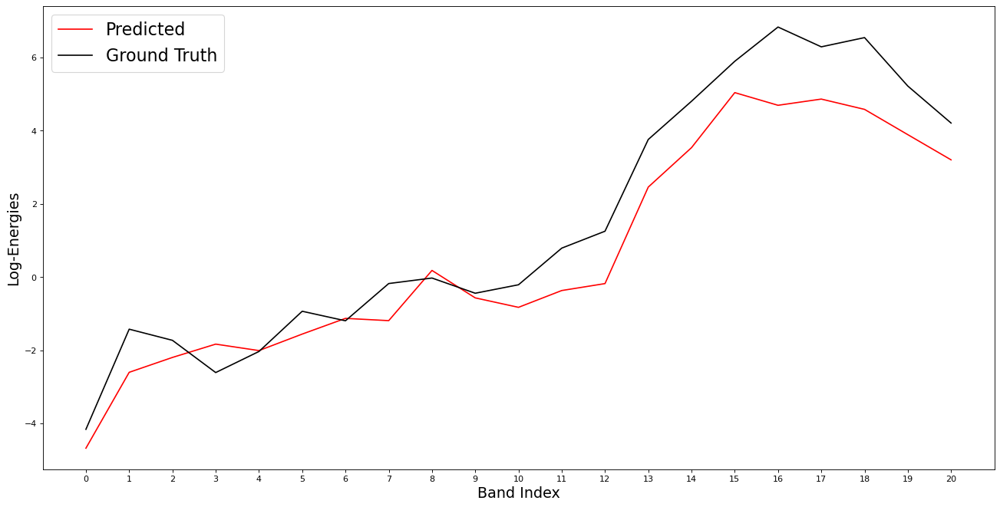

In [15]:
pyp.figure(figsize=(20, 10), dpi=80)
pyp.plot(log_tD_netout[1295],'r',label = 'Predicted')
pyp.plot(ee_celt.reshape(-1,21)[1295],'k',label = 'Ground Truth')
pyp.xticks(np.arange(21))
pyp.xlabel("Band Index",fontsize = "xx-large")
pyp.ylabel("Log-Energies",fontsize = "xx-large")
pyp.legend(loc = 'best',prop={'size':20})
pyp.savefig('energy_net_prediction.png')

### Shape Prediction Network

In [23]:
def audio_from_mdct(mdct_batches,band_E_batches, band_defs):
    l_audio = []
    
    for i in range(mdct_batches.shape[0]):
        band_E = band_E_batches[i,:,:]
        mdct_norm = mdct_batches[i,:,:]
        band_E = 2**(band_E + ebandMeans[:21])
        if mdct_norm.shape[-1]!=960:
            mdct_norm = np.concatenate((mdct_norm.squeeze(),np.zeros((mdct_norm.shape[0],160))),axis = -1)
        mdct_recon = mdctbands2mdct(mdct_norm,band_E,band_defs)
        recon_x = imdct_ola(mdct_recon,960*2,480*2,mdct_recon.shape[0]*960)
        recon_x = lfilter([1],[1,-0.85],recon_x)
        l_audio.append(recon_x)
    
    return np.stack(l_audio)

def rand_mdct_gen(n,band_defs):
    mdct = np.random.randn(n,960)
    for i in range(band_defs.shape[0] - 1):
        mdct[:,band_defs[i]:band_defs[i+1]] = mdct[:,band_defs[i]:band_defs[i+1]]/np.expand_dims(np.linalg.norm(mdct[:,band_defs[i]:band_defs[i+1]],axis = 1),-1)
    
    return mdct

def mdct_sampler(mu,sigma):
    mdct_unnormalized = np.zeros_like(mu)
    for i in range(mdct_unnormalized.shape[0]):
        for j in range(mdct_unnormalized.shape[1]):
            mu_distribution = mu[i,j,:]
            sigma_distribution = np.diag(np.exp(sigma[i,j,:]))
            mdct_unnormalized[i,j,:] = np.random.multivariate_normal(mu_distribution,sigma_distribution)
    
    return mdct_unnormalized

def renorm_mdct(mdct,band_defs):
    for i in range(band_defs.shape[0] - 1):
        mdct[:,:,band_defs[i]:band_defs[i+1]] = mdct[:,:,band_defs[i]:band_defs[i+1]]/np.expand_dims(np.linalg.norm(mdct[:,:,band_defs[i]:band_defs[i+1]],axis = 2),-1)
        # mdct[:,band_defs[i]:band_defs[i+1]] = mdct[:,band_defs[i]:band_defs[i+1]]*np.expand_dims(list_E[:,i],-1)
    return mdct

def autoregressive_plc_network(model,inp,inp_energy,loss):
    # loss[0] = 1
    # loss[1] = 1
    
    list_mdct = []
    previous_minus_one = shape_spectrum((inp_energy[:,:1,:] + ebandMeans[:21]),inp[:,:1,:],2,8)
    # previous_minus_one = inp[:,:1,:]
    list_mdct.append(inp[:,:1,:])
    previous = shape_spectrum((inp_energy[:,1:2,:] + ebandMeans[:21]),inp[:,1:2,:],2,8)
    # previous = inp[:,1:2,:]
    list_mdct.append(inp[:,1:2,:])
    for i in range(2,loss.shape[0]):
        inp_concat = np.concatenate((previous_minus_one,previous),axis = 1)
        current_prediction = np.expand_dims(model(np.expand_dims(inp_concat.transpose([0,2,1]),-1)).numpy(),0).transpose([0,2,1])[:,:1,:]
        if(loss[i] == 1):
            cur = shape_spectrum((inp_energy[:,i:i+1,:] + ebandMeans[:21]),inp[:,i:i+1,:],2,8)
            # list_mdct.append(invert_shape_spectrum(inp_energy[:,i:i+1,:] + ebandMeans[:21],cur,2,8).squeeze())
            list_mdct.append(inp[:,i:i+1,:])
            previous_minus_one = previous
            previous = cur
        else:
            list_mdct.append(invert_shape_spectrum(inp_energy[:,i:i+1,:] + ebandMeans[:21],current_prediction,2,8))
            previous_minus_one = previous
            previous = current_prediction
    
    return np.concatenate(list_mdct,1)

def autoregressive_plc_previous(inp,inp_E,loss):
    # loss[0] = 1
    # loss[1] = 1
    
    list_mdct = []
    list_E = []
    previous = inp[:,:1,:]
    previous_E = inp_E[:,:1,:]
    list_mdct.append(previous)
    list_E.append(previous_E)
    for i in range(1,loss.shape[0]):
        current_prediction = previous
        current_prediction_E = previous_E
        if(loss[i] == 1):            
            list_mdct.append(inp[:,i:i+1,:])
            list_E.append(inp_E[:,i:i+1,:])
            previous = inp[:,i:i+1,:]
            previous_E = inp_E[:,i:i+1,:]
        else:
            list_mdct.append(current_prediction)
            list_E.append(current_prediction_E)
            previous = current_prediction
            previous_E = current_prediction_E
    
    return np.concatenate(list_mdct,1),np.concatenate(list_E,1)

In [19]:
model_shape_cnn = opus_plc_network.plc_shape(nb_cepstral_features = int(band_defs[-1] - band_defs[0]),batch_size=18, band_defs = band_defs)
model_shape_cnn.load_weights('./final_weights/shape_model_testing_256_57.h5')

In [14]:
# Original audio shifted by 2 frames for comparison's sake

# energy_recon = np.roll(ee_celt,-2,1)
# mdct_og = np.roll(mm_celt[:,:,:800],-2,1)
# x_og = audio_from_mdct(mdct_og,energy_recon, band_defs)
# mdct_og = inverse_smoother(energy_recon,mdct_og)
# mdct_og = invert_shape_spectrum(energy_recon + ebandMeans[:21],mdct_og,2,8)

In [223]:
# net_pred_shape = model_shape_cnn(np.expand_dims(features_mdct_smooth.transpose([0,2,1]),-1)).numpy().transpose([0,2,1])
# net_pred_shape = autoregressive_plc_shape(model_shape_cnn,features_mdct_smooth,np.ones(100))
# net_pred_shape = invert_shape_spectrum(energy_recon + ebandMeans[:21],net_pred_shape,2,8).squeeze()
# net_pred_shape = renorm_mdct(net_pred_shape, band_defs)

### Doing PLC with the network outputs

In [20]:
energy_plc_cnn = np.copy(np.expand_dims(ee_celt.reshape(-1,21),0))
# energy_plc_cnn = np.copy(np.roll(energy_recon,0,1))
energy_plc_netpred = np.expand_dims(log_tD_netout,0)
energy_plc_cnn[:,inds,:] = energy_plc_netpred[:,inds,:]
# energy_plc_cnn = np.roll(energy_plc_cnn,-2,1) 

mdct_plc_cnn = autoregressive_plc_network(model_shape_cnn,np.expand_dims(mm_celt[:,:,:800].reshape(-1,800),0),energy_plc_cnn,lost_use)
mdct_plc_cnn = renorm_mdct(mdct_plc_cnn, band_defs)

plc_cnn_audio = audio_from_mdct(mdct_plc_cnn,energy_plc_cnn, band_defs)

In [24]:
mdct_plc_previous,energy_plc_previous = autoregressive_plc_previous(np.expand_dims(mm_celt[:,:,:800].reshape(-1,800),0),np.expand_dims(ee_celt.reshape(-1,21),0),lost_use)

plc_previous_audio = audio_from_mdct(mdct_plc_previous,energy_plc_previous, band_defs)

In [17]:
og_audio_reference = audio_from_mdct(np.expand_dims(mm_celt[:,:,:800].reshape(-1,800),0),np.expand_dims(ee_celt.reshape(-1,21),0), band_defs)

In [ ]:
# energy_plc_zeroed = np.copy(np.expand_dims(ee_celt.reshape(-1,21),0))
# # energy_plc_cnn = np.copy(np.roll(energy_recon,0,1))
# energy_plc_zeroed = np.expand_dims(log_tD_netout,0)
# energy_plc_zeroed[:,inds,:] = -500*np.ones_like(energy_plc_zeroed[:,inds,:])
# # energy_plc_cnn = np.roll(energy_plc_cnn,-2,1) 

# # mdct_plc_cnn = autoregressive_plc_network(model_shape_cnn,np.expand_dims(mm_celt[:,:,:800].reshape(-1,800),0),energy_plc_cnn + ebandMeans[:21],lost_use)
# # mdct_plc_cnn = renorm_mdct(mdct_plc_cnn, band_defs)

# plc_cnn_zeroed_ref = audio_from_mdct(np.expand_dims(mm_celt[:,:,:800].reshape(-1,800),0),energy_plc_zeroed, band_defs)

In [25]:
# IPython.display.display(IPython.display.Audio(data = og_audio_reference[0],rate = 48000))
# IPython.display.display(IPython.display.Audio(data = plc_cnn_audio[0],rate = 48000))
IPython.display.display(IPython.display.Audio(data = plc_previous_audio[0],rate = 48000))
# IPython.display.display(IPython.display.Audio(data = plc_cnn_zeroed_ref[0],rate = 48000))

In [44]:
wavwrite16('./audio/plc_cnn_80percent.wav',plc_cnn_audio[0].astype('int16'),48000)
wavwrite16('./audio/plc_previous_80percent.wav',plc_previous_audio[0].astype('int16'),48000)
# wavwrite16('./audio/plc_previous_20percent_zeroed.wav',plc_cnn_zeroed_ref[0].astype('int16'),48000)
# wavwrite16('./audio/plc_previous_20percent_og.wav',og_audio_reference[0].astype('int16'),48000)

### This is sandbox territory, enter at your own risk :P

In [134]:
energy_plc_cnn = np.copy(np.roll(energy_recon,2,1))
# energy_plc_cnn = np.copy(np.roll(energy_recon,0,1))
energy_plc_cnn[:,inds,:] = net_pred_energy[:,inds,:]
energy_plc_cnn = np.roll(energy_plc_cnn,-2,1) 

mdct_plc_cnn = autoregressive_plc_network(model_shape_cnn,mdct_og,energy_plc_cnn + ebandMeans[:21],lost_use)
mdct_plc_cnn = renorm_mdct(mdct_plc_cnn, band_defs)

plc_cnn_audio = audio_from_mdct(mdct_plc_cnn,energy_plc_cnn, band_defs)

In [135]:
# energy_plc_previous = np.copy(np.roll(energy_recon,2,1))
# energy_plc_previous[:,inds,:] = np.roll(energy_recon,2,1)[:,inds - 1,:]
# energy_plc_previous = np.roll(energy_plc_previous,-2,1) 

mdct_plc_previous,energy_plc_previous = autoregressive_plc_previous(mdct_og,energy_recon,lost_use)

plc_previous_audio = audio_from_mdct(mdct_plc_previous,energy_plc_previous, band_defs)

In [136]:
IPython.display.display(IPython.display.Audio(data = x_og[1],rate = 48000))
IPython.display.display(IPython.display.Audio(data = plc_cnn_audio[1],rate = 48000))
IPython.display.display(IPython.display.Audio(data = plc_previous_audio[1],rate = 48000))

In [102]:
wavwrite16('./audio/plc_cnn_20percent.wav',plc_cnn_audio[1].astype('int16'),48000)
wavwrite16('./audio/plc_previous_20percent.wav',plc_previous_audio[1].astype('int16'),48000)

In [137]:
print(np.linalg.norm(plc_cnn_audio[1] - x_og[1]))
print(np.linalg.norm(plc_previous_audio[1] - x_og[1]))

742837.0349088383
935422.5045881128


In [36]:
inds

array([ 0,  3,  6,  9, 12, 15, 18, 21, 24, 27, 30, 33, 36, 39, 42, 45, 48,
       51, 54, 57, 60, 63, 66, 69, 72, 75, 78, 81, 84, 87, 90, 93, 96, 99])

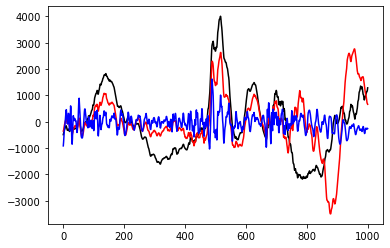

In [236]:
pyp.plot(x_og[1][5500:6500],'k')
pyp.plot(plc_cnn_audio[1][5500:6500],'r')
pyp.plot(plc_previous_audio[1][5500:6500],'b')

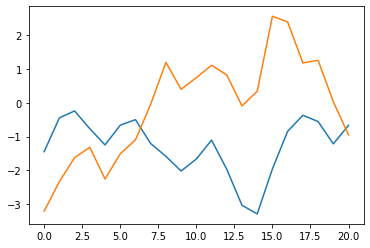

In [77]:
pyp.plot(energy_plc_cnn[1,1,:])
pyp.plot(energy_recon[1,1,:])

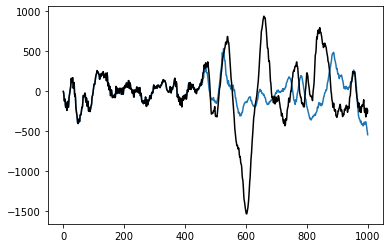

In [121]:
pyp.plot(plc_cnn_audio_test[1][:1000])
pyp.plot(plc_cnn_audio[1][:1000],'k')

In [36]:
mdct_plc_cnn = np.copy(np.roll(mdct_og,2,1))
mdct_plc_cnn[:,inds,:] = np.roll(net_pred_shape,2,1)[:,inds,:]
mdct_plc_cnn = np.roll(mdct_plc_cnn,-2,1)      

energy_plc_cnn = np.copy(np.roll(energy_recon,2,1))
# energy_plc_cnn = np.copy(np.roll(energy_recon,0,1))
energy_plc_cnn[:,inds,:] = net_pred_energy[:,inds,:]
energy_plc_cnn = np.roll(energy_plc_cnn,-2,1)  

plc_cnn_audio = audio_from_mdct(mdct_plc_cnn,energy_plc_cnn, band_defs)

In [37]:
IPython.display.display(IPython.display.Audio(data = plc_cnn_audio[1],rate = 48000))

In [25]:
mdct_plc_previous = np.copy(np.roll(mdct_og,2,1))
mdct_plc_previous[:,inds,:] = np.roll(mdct_og,2,1)[:,inds - 1,:]
mdct_plc_previous = np.roll(mdct_plc_previous,-2,1)      

energy_plc_previous = np.copy(np.roll(energy_recon,2,1))
energy_plc_previous[:,inds,:] = np.roll(energy_recon,2,1)[:,inds - 1,:]
energy_plc_previous = np.roll(energy_plc_previous,-2,1) 

plc_previous_audio = audio_from_mdct(mdct_plc_previous,energy_plc_previous, band_defs)

In [26]:
mdct_plc_zeroed = np.copy(np.roll(mdct_og,2,1))
mdct_plc_zeroed[:,inds,:] = np.roll(mdct_og,2,1)[:,inds - 1,:]
mdct_plc_zeroed = np.roll(mdct_plc_zeroed,-2,1)      

energy_plc_zeroed = np.copy(np.roll(energy_recon,2,1))
energy_plc_zeroed[:,inds,:] = 0*np.roll(energy_recon,2,1)[:,inds - 1,:]
energy_plc_zeroed = np.roll(energy_plc_zeroed,-2,1) 

plc_zeroed_audio = audio_from_mdct(mdct_plc_zeroed,energy_plc_zeroed, band_defs)

In [27]:
IPython.display.display(IPython.display.Audio(data = plc_cnn_audio[1],rate = 48000))
IPython.display.display(IPython.display.Audio(data = plc_previous_audio[1],rate = 48000))
IPython.display.display(IPython.display.Audio(data = plc_zeroed_audio[1],rate = 48000))

In [28]:
print(np.linalg.norm(plc_cnn_audio[0] - x_og[0]))
print(np.linalg.norm(plc_previous_audio[0] - x_og[0]))

547767.2853617113
911459.9236718458


In [151]:
wavwrite16('./audio/plc_cnn_nocheat.wav',plc_cnn_audio[0].astype('int16'),48000)
wavwrite16('./audio/plc_previous_nocheat.wav',plc_previous_audio[0].astype('int16'),48000)

In [152]:
IPython.display.display(IPython.display.Audio('./audio/plc_cnn_nocheat.wav'))
IPython.display.display(IPython.display.Audio('./audio/plc_previous_nocheat.wav'))

In [63]:
net_pred_shape.shape

(18, 100, 800)

In [ ]:
net_pred_shape_cnn = model_shape_cnn(t[0]).numpy().T
# mdct_pred_shape_cnn = mdct_sampler(net_pred_shape_cnn[:,:,:,0],net_pred_shape_cnn[:,:,:,1])
net_pred_shape_cnn = net_pred_shape_cnn
net_pred_shape_cnn = invert_shape_spectrum(energy_recon + ebandMeans[:21],net_pred_shape_cnn,2,8).squeeze()
# net_pred_shape_cnn = renorm_mdct(net_pred_shape_cnn, band_defs)
net_pred_shape_cnn = np.concatenate((net_pred_shape_cnn.squeeze(),np.zeros((100,160))),axis = -1)
recon_x_shapepred_cnn = audio_from_mdct(net_pred_shape_cnn,energy_recon.squeeze(),band_defs_recon)

In [48]:
l = audio_from_mdct(mdct_og,energy_recon, band_defs)

In [49]:
IPython.display.display(IPython.display.Audio(data = l[0],rate = 48000))

In [41]:
np.stack(l).shape

(18, 96000)

In [ ]:
# JAN NORM RECON
t = z[3]

# Common energy for all reconstructions
# energy_og = t[1].squeeze()
energy_recon = np.roll(ee_celt,-2,1)
mdct_og = mm_celt.transpose([0,2,1])
# mdct_og = inverse_smoother(energy_recon,mdct_og)
mdct_og = invert_shape_spectrum(energy_recon + ebandMeans[:21],mdct_og,2,8)
x_og = audio_from_mdct(mdct_og.squeeze(),energy_recon.squeeze(),band_defs_recon)

# net_pred_shape_rand = model_shape_init([t[0][0][:,band_defs[0]:band_defs[-1],:,:],t[0][1]]).numpy()
net_pred_shape_rand = rand_mdct_gen(100,band_defs)
# net_pred_shape_rand = np.concatenate((net_pred_shape_rand,t[0][0].squeeze()[band_defs[-1]:,:]),axis = 0).T
recon_x_shapepred_rand = audio_from_mdct(net_pred_shape_rand,energy_recon.squeeze(),band_defs_recon)

# net_pred_shape_dense = model_shape_dense(t[0][:,band_defs[0]:band_defs[-1],:,:]).numpy()
# net_pred_shape_dense = np.concatenate((net_pred_shape_dense,t[0].squeeze()[band_defs[-1]:,:]),axis = 0).T
# recon_x_shapepred_dense = audio_from_mdct(net_pred_shape_dense,energy_recon,band_defs_recon)

net_pred_shape_cnn = model_shape_cnn(t[0]).numpy().T
# mdct_pred_shape_cnn = mdct_sampler(net_pred_shape_cnn[:,:,:,0],net_pred_shape_cnn[:,:,:,1])
net_pred_shape_cnn = net_pred_shape_cnn
net_pred_shape_cnn = invert_shape_spectrum(energy_recon + ebandMeans[:21],net_pred_shape_cnn,2,8).squeeze()
# net_pred_shape_cnn = renorm_mdct(net_pred_shape_cnn, band_defs)
net_pred_shape_cnn = np.concatenate((net_pred_shape_cnn.squeeze(),np.zeros((100,160))),axis = -1)
recon_x_shapepred_cnn = audio_from_mdct(net_pred_shape_cnn,energy_recon.squeeze(),band_defs_recon)

shape_recon_previous = np.roll(mdct_og.squeeze(),1,-1)
shape_recon_previous = np.concatenate((shape_recon_previous,np.zeros((100,160))),axis = -1)
recon_x_shapepred_previous = audio_from_mdct(shape_recon_previous,energy_recon.squeeze(),band_defs_recon)

In [39]:
# Dumb PLC
mdct_dumbplc_x = mdctbands2mdct_withplc(mdct_normalized,band_E_og,band_defs,lost.reshape(-1),choice = 2)
recon_x_dumbbplc = imdct_ola(mdct_dumbplc_x,N,H,log_tD_netout.shape[0]*N//2)
recon_x_dumbbplc = lfilter([1],[1,-0.85],recon_x_dumbbplc)

In [40]:
band_E_og.shape

(1800, 21)

In [41]:
np.count_nonzero(np.delete((lost.reshape(-1) == 0),0))

709

In [42]:
IPython.display.display(IPython.display.Audio(data = recon_x_dumbbplc,rate = 48000))

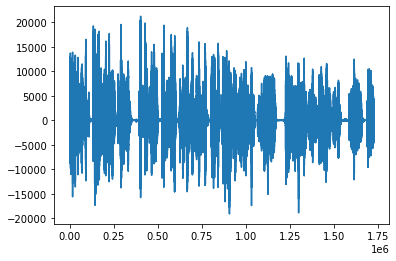

In [18]:
pyp.plot(recon_x_og)

### Playing around

In [25]:
# Normal Reconstruction/Playing around with the entire audio
band_E_recon = 2**(log_tD_netout + ebandMeans[:21])
mdct_recon_x_randE = mdctbands2mdct(mdct_normalized,np.random.randn(*band_E_recon.shape)**2,band_defs)
recon_x_randE = imdct_ola(mdct_recon_x_randE,N,H,log_tD_netout.shape[0]*N//2)

mdct_normalized_random = np.copy(mdct_normalized)
for i in range(band_defs.shape[0] - 1):
    rV = np.random.randn(mdct_normalized_random.shape[0],band_defs[i+1] - band_defs[i])
    rV = rV/np.linalg.norm(rV,axis = 0)
    mdct_normalized_random[:,band_defs[i]:band_defs[i+1]] = rV*band_E_recon[:,i][:,None]
recon_x_randmdct = imdct_ola(mdct_normalized_random,N,H,log_tD_netout.shape[0]*N//2)

In [26]:
IPython.display.display(IPython.display.Audio(data = recon_x_randE,rate = 48000))
IPython.display.display(IPython.display.Audio(data = recon_x_randmdct,rate = 48000))

In [5]:
band_E_recon = 2**(log_tD_netout + ebandMeans[:21])
mdct_plcnet_x = mdctbands2mdct_withplc(mdct_normalized,band_E_recon,band_defs,lost.reshape(-1))
recon_x_plcnet = imdct_ola(mdct_plc_x,N,H,log_tD_netout.shape[0]*N//2)

In [7]:
IPython.display.display(IPython.display.Audio(data = recon_x,rate = 48000))

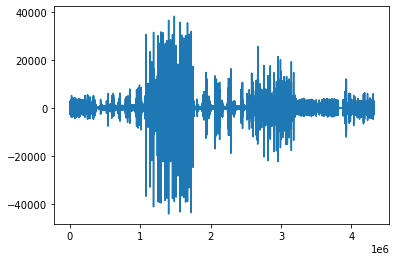

In [15]:
pyp.plot(recon_x)

In [36]:
np.where(lost.reshape(-1)[:20] == 0)

(array([ 2,  6,  7,  8,  9, 12, 13, 14, 15, 16, 17, 18]),)

In [34]:
inds = np.where(lost.reshape(-1)==0)[0]

In [2]:
inds.shape[0]!=0

NameError: name 'inds' is not defined